# Feature Similarity Between Asian Elephants

<h3><u>Using Contrastive Loss</u></h3>


## Imports

In [1]:
import torchvision
import torchvision.datasets as dset
import torchvision.transforms as transforms
from torch.utils.data import DataLoader,Dataset
import matplotlib.pyplot as plt
import torchvision.utils
import numpy as np
import random
from PIL import Image
import torch
from torch.autograd import Variable
import PIL.ImageOps    
import torch.nn as nn
from torch import optim
import torch.nn.functional as F
import os
from torchvision import models

 
%matplotlib inline


## Helper functions

In [2]:
## visualization helper
def imshow(img,text=None,should_save=False):
    npimg = img.numpy()
    image = np.transpose(npimg,(1,2,0))
    
    # Undo preprocessing
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    image = std * image + mean
    plt.figure(figsize=(20,12))
    plt.axis("off")
    if text:
        plt.text(75, 8, text, style='italic',fontweight='bold',
            bbox={'facecolor':'white', 'alpha':0.8, 'pad':10})
        
    image = np.clip(image, 0, 1)
    plt.imshow(image)
    plt.show() 
        
def visualize_loss(epochs, loss):
    plt.plot(range(epochs),loss)
    plt.show()
    
    
class RunningAverage(object):
    """Computes and stores the average and current value"""
    def __init__(self, name, fmt=':f'):
        self.name = name
        self.fmt = fmt
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

    def __str__(self):
        fmtstr = '{name} {val' + self.fmt + '} ({avg' + self.fmt + '})'
        return fmtstr.format(**self.__dict__)

## Configuration

In [50]:
class Config():
    ## Noisy Dataset
    train_dir = "/share/jproject/fg508/mchivuku/datasets/asian_elephant/models/baseline-data/train"
    
    ## Superclean Imageset
    val_dir = "/N/u/mchivuku/asian_elephant_facial_recognition/data/val"
    
    ## New test photos
    test_dir = "/N/u/mchivuku/asian_elephant_facial_recognition/data/New Test Photos/"
    
    
    ## Gallery images
    gallery_dir = "/N/u/mchivuku/asian_elephant_facial_recognition/data/gallery_images/"
    ## Query images
    query_dir = "/N/u/mchivuku/asian_elephant_facial_recognition/data/query_images/"
    
    batch_size = 128
    nepochs = 100
    learning_rate = 0.001
    num_classes = 14
    test_freq = 20
        
        
print(Config.train_dir)      

/share/jproject/fg508/mchivuku/datasets/asian_elephant/models/baseline-data/train


## Dataset and Dataloaders

In [4]:
## Dataset - build pairs of images - 0, same class, 1 for opposite pair
class AsianElephantSiemeseDataset(Dataset):
    def __init__(self,imagefolder_dataset, transform = None):
        self.imagefolder_dataset = imagefolder_dataset
        self.transform = transform
        
    def __getitem__(self,index):
        img0_tuple = random.choice(self.imagefolder_dataset.imgs)
        
        ## 50% same class and 50% opposite class
        same_class = random.randint(0,1)
        if same_class:
            ## loop until we find image of the same class
            while True:
                ##
                img1_tuple = random.choice(self.imagefolder_dataset.imgs)
                if img0_tuple[1]==img1_tuple[1]:
                    ## found image so, break
                    break
        else:
            while True:
                img1_tuple = random.choice(self.imagefolder_dataset.imgs) 
                if img0_tuple[1] !=img1_tuple[1]:
                    break
                    
        img0 = Image.open(img0_tuple[0])
        img1 = Image.open(img1_tuple[0])
        
        label0 = img0_tuple[1]
        label1 = img1_tuple[1]
        
        ## convert to PIL image
        img0 = img0
        img1 = img1
        
        if self.transform is not None:
            img0 = self.transform(img0)
            img1 = self.transform(img1)
            
        return img0, img1 , torch.from_numpy(np.array([int(img1_tuple[1]!=img0_tuple[1])],dtype=np.float32)), (label0,label1)
    
    
    def __len__(self):
        return len(self.imagefolder_dataset.imgs)
    

##### Image Folders

Train - All images
<br/>
Val - Superclean images
<br/>
Test - New Test Photos

In [5]:
## Train Image Folder, Test Image Folder

train_image_folder = dset.ImageFolder(root = Config.train_dir)

classes = train_image_folder.classes

In [7]:
## Dataloaders
normalize = torchvision.transforms.Normalize(
mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])

data_transforms = {
        'train': torchvision.transforms.Compose([
        torchvision.transforms.RandomResizedCrop(224),
        torchvision.transforms.RandomHorizontalFlip(),
        torchvision.transforms.ToTensor(),
        normalize,
        ]),
     
      'test': torchvision.transforms.Compose([
                               torchvision.transforms.Resize(256),
                               torchvision.transforms.CenterCrop(224),
                               torchvision.transforms.ToTensor(),normalize


        ])

    }

train_dataset = AsianElephantSiemeseDataset(train_image_folder,data_transforms["train"])


In [8]:
print(f" Number of train images:{len(train_dataset)}")

 Number of train images:19290


### DataLoaders

In [9]:
train_loader = DataLoader(train_dataset,
                        shuffle=True,
                        num_workers=4,pin_memory=True,
                        batch_size=Config.batch_size)




In [10]:
val_image_folder = dset.ImageFolder(root = Config.val_dir, transform=data_transforms["test"])
val_loader = torch.utils.data.DataLoader(val_image_folder,batch_size=len(val_image_folder), sampler=None,num_workers=4,pin_memory=True)
val_origin, val_y_origin = next(iter(val_loader))



In [49]:
## Gallery Images
gallery_image_folder = dset.ImageFolder(root=Config.gallery_dir, transform = data_transforms["test"])
gallery_loader = torch.utils.data.DataLoader(gallery_image_folder, batch_size = len(gallery_image_folder), sampler=None, 
                                        num_workers = 4,shuffle=True)
gallery_origin, gallery_y_origin = next(iter(gallery_loader))


# Test Images
test_image_folder = dset.ImageFolder(root = Config.test_dir, transform = data_transforms["test"])
test_loader = torch.utils.data.DataLoader(test_image_folder,batch_size=len(test_image_folder), sampler=None,num_workers=4,pin_memory=True)
test_origin, test_y_origin = next(iter(test_loader))



## Visualize Some Examples

## Train Set

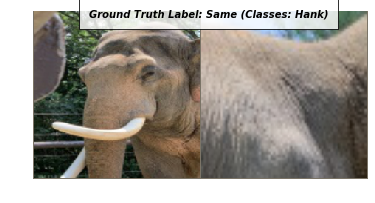

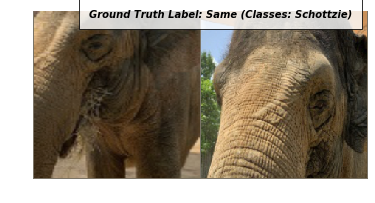

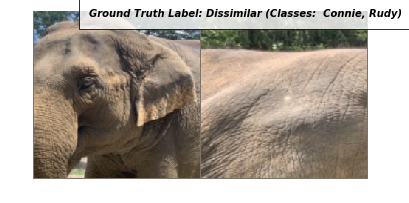

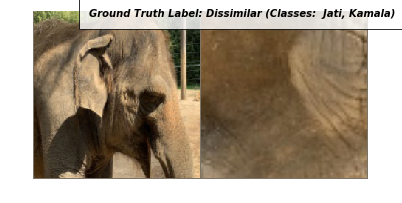

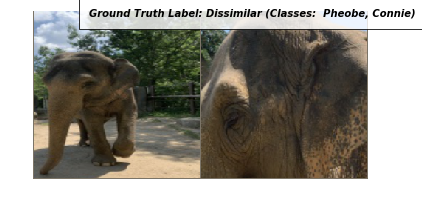

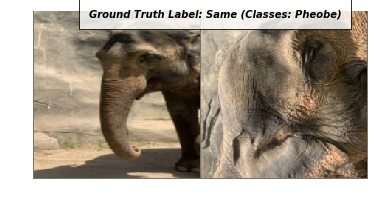

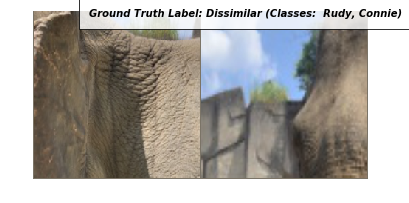

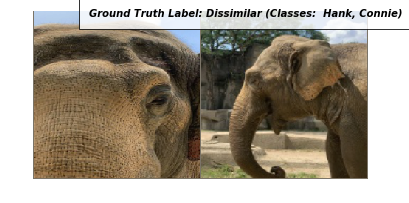

In [63]:
batch_size = 4
vis_dataloader = DataLoader(train_dataset,
                        shuffle=False,
                        num_workers=8,
                        batch_size=1)
dataiter = iter(vis_dataloader)


nrows = 4
ncols = 3

for batch_idx in range(8):
    example_batch = next(dataiter)
    concatenated = torch.cat((example_batch[0],example_batch[1]),0)
    title = "Ground Truth Label: " + ",  ".join([("Same" if i[0]==0.0 else "Dissimilar") for i in example_batch[2].numpy()])
    if example_batch[2][0]==0.0:
        title+= " (Classes: "+ classes[example_batch[3][0]] +")"
    else:
        title+=" (Classes: "+ f" {classes[example_batch[3][0]]}, {classes[example_batch[3][1]]}" + ")"
    imshow(torchvision.utils.make_grid(concatenated),title, False)
            

### Validation Images

In [119]:
batch_size = 4
vis_val_dataloader = DataLoader(val_image_folder,
                        shuffle=False,
                        num_workers=8,
                        batch_size=len(val_image_folder))
dataiter = iter(vis_val_dataloader)





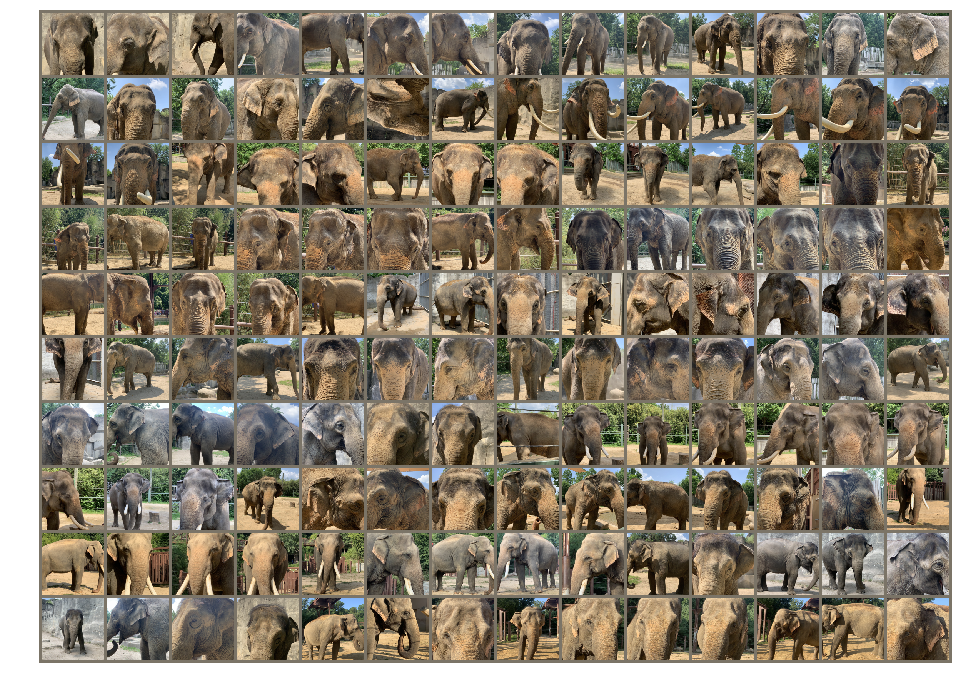

Label: Beco,Beco,Beco,Beco,Beco,Beco,Beco,Beco,Beco,Beco,Connie,Connie,Connie,Connie,Connie,Connie,Connie,Connie,Connie,Connie,Hank,Hank,Hank,Hank,Hank,Hank,Hank,Hank,Hank,Hank,Jati,Jati,Jati,Jati,Jati,Jati,Jati,Jati,Jati,Jati,Kamala,Kamala,Kamala,Kamala,Kamala,Kamala,Kamala,Kamala,Kamala,Kamala,Maharani,Maharani,Maharani,Maharani,Maharani,Maharani,Maharani,Maharani,Maharani,Maharani,Maharani,MyThai,MyThai,MyThai,MyThai,MyThai,MyThai,MyThai,MyThai,MyThai,MyThai,Pheobe,Pheobe,Pheobe,Pheobe,Pheobe,Pheobe,Pheobe,Pheobe,Pheobe,Pheobe,Rudy,Rudy,Rudy,Rudy,Rudy,Rudy,Rudy,Rudy,Rudy,Rudy,Sabu,Sabu,Sabu,Sabu,Sabu,Sabu,Sabu,Sabu,Sabu,Sabu,Schottzie,Schottzie,Schottzie,Schottzie,Schottzie,Schottzie,Schottzie,Schottzie,Schottzie,Schottzie,Spike,Spike,Spike,Spike,Spike,Spike,Spike,Spike,Spike,Spike,Sunny,Sunny,Sunny,Sunny,Sunny,Sunny,Sunny,Sunny,Sunny,Swarna,Swarna,Swarna,Swarna,Swarna,Swarna,Swarna,Swarna,Swarna,Swarna


In [120]:
nrows = 4
ncols = 3
concatenated, label = next(dataiter)

title = "Label: "+ ",".join([classes[l] for l in label])+""
grid = torchvision.utils.make_grid(concatenated,nrow=14,padding=10)
npimg = grid.detach().cpu() # to numpy array
imshow(npimg)
print(title)

## Model

In [14]:
import copy
import math
__all__ = ['ResNet', 'resnet18', 'resnet34', 'resnet50', 'resnet101',
           'resnet152']

model_urls = {
    'resnet18': 'https://download.pytorch.org/models/resnet18-5c106cde.pth',
    'resnet34': 'https://download.pytorch.org/models/resnet34-333f7ec4.pth',
    'resnet50': 'https://download.pytorch.org/models/resnet50-19c8e357.pth',
    'resnet101': 'https://download.pytorch.org/models/resnet101-5d3b4d8f.pth',
    'resnet152': 'https://download.pytorch.org/models/resnet152-b121ed2d.pth',
}


def conv3x3(in_planes, out_planes, stride=1):
    "3x3 convolution with padding"
    return nn.Conv2d(in_planes, out_planes, kernel_size=3, stride=stride,
                     padding=1, bias=False)


class BasicBlock(nn.Module):
    expansion = 1

    def __init__(self, inplanes, planes, stride=1, downsample=None):
        super(BasicBlock, self).__init__()
        self.conv1 = conv3x3(inplanes, planes, stride)
        self.bn1 = nn.BatchNorm2d(planes)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = conv3x3(planes, planes)
        self.bn2 = nn.BatchNorm2d(planes)
        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        residual = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)

        if self.downsample is not None:
            residual = self.downsample(x)

        out += residual
        out = self.relu(out)

        return out


class Bottleneck(nn.Module):
    expansion = 4

    def __init__(self, inplanes, planes, stride=1, downsample=None):
        super(Bottleneck, self).__init__()
        self.conv1 = nn.Conv2d(inplanes, planes, kernel_size=1, bias=False)
        self.bn1 = nn.BatchNorm2d(planes)
        self.conv2 = nn.Conv2d(planes, planes, kernel_size=3, stride=stride,
                               padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(planes)
        self.conv3 = nn.Conv2d(planes, planes * 4, kernel_size=1, bias=False)
        self.bn3 = nn.BatchNorm2d(planes * 4)
        self.relu = nn.ReLU(inplace=True)
        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        residual = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)
        out = self.relu(out)

        out = self.conv3(out)
        out = self.bn3(out)

        if self.downsample is not None:
            residual = self.downsample(x)

        out += residual
        out = self.relu(out)

        return out


class ResNet(nn.Module):

    def __init__(self, block, layers, num_classes=14):
        
        self.inplanes = 64
        
        super(ResNet, self).__init__()
        
        self.conv1 = nn.Conv2d(3, 64, kernel_size=7, stride=2, padding=3,
                               bias=False)
        
        self.bn1 = nn.BatchNorm2d(64)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        
        self.layer1 = self._make_layer(block, 64, layers[0])
        self.layer2 = self._make_layer(block, 128, layers[1], stride=2)
        self.layer3 = self._make_layer(block, 256, layers[2], stride=2)
        self.layer4 = self._make_layer(block, 512, layers[3], stride=2)
        self.avgpool = nn.AvgPool2d(7)
        
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                n = m.kernel_size[0] * m.kernel_size[1] * m.out_channels
                m.weight.data.normal_(0, math.sqrt(2. / n))
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()

    def _make_layer(self, block, planes, blocks, stride=1):
        downsample = None
        if stride != 1 or self.inplanes != planes * block.expansion:
            downsample = nn.Sequential(
                nn.Conv2d(self.inplanes, planes * block.expansion,
                          kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(planes * block.expansion),
            )

        layers = []
        layers.append(block(self.inplanes, planes, stride, downsample))
        self.inplanes = planes * block.expansion
        for i in range(1, blocks):
            layers.append(block(self.inplanes, planes))

        return nn.Sequential(*layers)

    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        x = self.avgpool(x)
        x = x.view(x.size(0), -1)
        
        return x


In [15]:
class AsianElephantSiemeseNetwork(nn.Module):
    def __init__(self,resnet_conv,convout_dimension):
        super(AsianElephantSiemeseNetwork,self).__init__()
        ## check with Shujon
        self.resnet_conv = resnet_conv
        self.convout_dimension = convout_dimension
        
    def forward_once(self, x):
        x = self.resnet_conv(x)
        return x.view(-1,self.convout_dimension)

    def forward(self, input1, input2):
        output1 = self.forward_once(input1)
        output2 = self.forward_once(input2)
        return output1, output2


## Contrastive Loss

In [16]:
class ContrastiveLoss(torch.nn.Module):
    """
    Contrastive Loss
    """
    def __init__(self, margin = 2.0):
        super(ContrastiveLoss,self).__init__()
        self.margin = margin
        
        
    def forward(self, output1, output2, label):
        euclidean_distance = F.pairwise_distance(output1, output2, keepdim = True)
        loss_contrastive = torch.mean((1-label) * torch.pow(euclidean_distance, 2) +
                                      (label) * torch.pow(torch.clamp(self.margin - euclidean_distance, min=0.0), 2))
        
        return loss_contrastive
    


## Evaluation Metrics

Evaluation Metric is different from traditional classifier network

Reference: https://medium.com/@crimy/one-shot-learning-siamese-networks-and-triplet-loss-with-keras-2885ed022352

In [18]:
from sklearn.metrics import roc_curve,roc_auc_score

def compute_prob(network, X, Y):
    """
      Input: network - model
      X: input tensor - containing images to evaluate"
      Y: tensor containing true class
    """
    
    m = X.shape[0]
    nbevaluation = int(m*(m-1)/2)
    probs = np.zeros(nbevaluation)
    y = np.zeros(nbevaluation)
    
    ## compute all embeddings
    embeddings = model.module.forward_once(X.cuda()).detach().cpu()
    embeddings = embeddings.numpy()
    size_embedding = embeddings.shape[1]

    ## for each image in the dataset
    k = 0
    for i in range(m):
        ## Against all others images
        for j in range(i+1, m):
            probs[k] = compute_dist(embeddings[i,:],embeddings[j,:])
            if Y[i] == Y[j]:
                y[k] = 0
                #print("{3}:{0} vs {1} : {2}\tSAME".format(i,j,probs[k],k))
            else:
                y[k] = 1
                #print("{3}:{0} vs {1} : \t\t\t{2}\tDIFF".format(i,j,probs[k],k))
            k+=1
    return probs, y

## Compute Pairwise Euclidean Distance
def compute_dist(a,b):
    return np.sum(np.square(a-b))

def compute_metrics(probs,yprobs):
    '''
    Returns
        fpr : Increasing false positive rates such that element i is the false positive rate of predictions with score >= thresholds[i]
        tpr : Increasing true positive rates such that element i is the true positive rate of predictions with score >= thresholds[i].
        thresholds : Decreasing thresholds on the decision function used to compute fpr and tpr. thresholds[0] represents no instances being predicted and is arbitrarily set to max(y_score) + 1
        auc : Area Under the ROC Curve metric
    '''
    # calculate AUC
    auc = roc_auc_score(yprobs, probs)
    # calculate roc curve
    fpr, tpr, thresholds = roc_curve(yprobs, probs)
    
    return fpr, tpr, thresholds,auc

def compute_interdist(model,img_folder):
    '''
    Computes sum of distances between all classes embeddings on our reference test image: 
        d(0,1) + d(0,2) + ... + d(0,9) + d(1,2) + d(1,3) + ... d(8,9)
        A good model should have a large distance between all theses embeddings
        
    Returns:
        array of shape (nb_classes,nb_classes) 
    '''
    nb_classes = Config.num_classes
    res = np.zeros((nb_classes,nb_classes))
    
    ref_images = np.zeros((nb_classes,3,224,224))
    occurrences = lambda s, lst: (i for i,e in enumerate(lst) if e == s)
    transform = torchvision.transforms.Compose([
            torchvision.transforms.Resize(256),
            torchvision.transforms.CenterCrop(224),
            torchvision.transforms.ToTensor(),
            normalize,
           
        ])
    
    #generates embeddings for reference images
    targets = [i[1] for i in val_image_folder.imgs]

    for i in range(nb_classes):
        target_idx = list(occurrences(0,targets))
        for index in target_idx:
            img_path = img_folder.imgs[index][0]
            img = Image.open(img_path)
            img = img.convert("RGB")
          
            ref_images[i,:,:,:] = transform(img)
        
            
    ref_embeddings = model.module.forward_once(torch.from_numpy(ref_images).float().cuda()).detach().cpu()
    ref_embeddings = ref_embeddings.numpy()
    for i in range(nb_classes):
        for j in range(nb_classes):
            res[i,j] = compute_dist(ref_embeddings[i],ref_embeddings[j])
    return res


def draw_interdist(model, epoch,img_folder):
    data = []
    interdist = compute_interdist(model,img_folder)
    
    nb_classes = len(classes)
    for i in range(nb_classes):
        data.append(np.delete(interdist[i,:],[i]))

    fig, ax = plt.subplots()
    ax.set_title('Evaluating embeddings distance from each other after {0} iterations'.format(epoch))
    ax.set_ylim([0,3])

    plt.xlabel('Classes')
    plt.ylabel('Distance')
    
    ax.boxplot(data,showfliers=False,showbox=True)
    locs, labels = plt.xticks()
    plt.xticks(locs,np.arange(nb_classes))
    plt.show()
    
def find_nearest(array,value):
    idx = np.searchsorted(array, value, side="left")
    if idx > 0 and (idx == len(array) or math.fabs(value - array[idx-1]) < math.fabs(value - array[idx])):
        return array[idx-1],idx-1
    else:
        return array[idx],idx

        
def draw_roc(fpr, tpr,thresholds):
    #find threshold
    targetfpr=1e-3
    _, idx = find_nearest(fpr,targetfpr)
    threshold = thresholds[idx]
    recall = tpr[idx]
    
    
    # plot no skill
    plt.plot([0, 1], [0, 1], linestyle='--')
    # plot the roc curve for the model
    plt.plot(fpr, tpr, marker='.')
    plt.title('AUC: {0:.3f}\nSensitivity : {2:.1%} @FPR={1:.0e}\nThreshold={3})'.format(auc,targetfpr,recall,abs(threshold) ))
    # show the plot
    plt.show()


## Training

In [19]:
model = ResNet(BasicBlock, [3, 4, 6, 3])

model = AsianElephantSiemeseNetwork(model, 512)
if torch.cuda.is_available:
    if torch.cuda.device_count()>1:
        print("Let's use", torch.cuda.device_count(), "GPUs!")
        model = nn.DataParallel(model)
    model = model.cuda()
    
    

Let's use 8 GPUs!


In [20]:
criterion = ContrastiveLoss()
if torch.cuda.device_count()>1:
    optimizer = optim.Adam(model.module.parameters(),lr = Config.learning_rate)
else:
    optimizer = optim.Adam(model.parameters(),lr = Config.learning_rate)

In [21]:
def train(epoch):
    model.train()
    losses = RunningAverage("train loss per batch")
    
    for i, data in enumerate(train_loader):
        img0, img1 , label, actual_labels = data
        img0, img1 , label = img0.cuda(), img1.cuda() , label.cuda()
        
        ## Optimizer - reset gradients
        optimizer.zero_grad()
        
        ## forward pass, extract features
        features1,features2 = model(img0,img1)
        
        ## compute contrastive loss
        loss_contrastive = criterion(features1,features2,label)
        
        ## Backward pass and update
        losses.update(loss_contrastive.item(), label.size(0))
        loss_contrastive.backward()
        
        ## update the weights
        optimizer.step()
        
    return losses.avg




Starting training process!
----------------------------------------------------------------------------------------------------
0 Train Loss: 1.6940

 ------------- 

[0] Time for 0 iterations: 3.1 mins, Train Loss: 1.6940107106853484


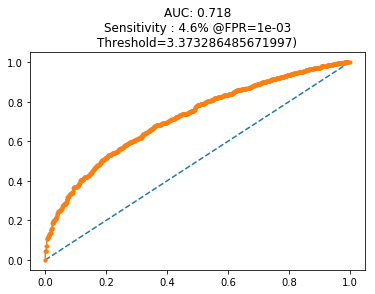

1 Train Loss: 0.9276
2 Train Loss: 0.9018
3 Train Loss: 0.8790
4 Train Loss: 0.8490
5 Train Loss: 0.8249

 ------------- 

[5] Time for 5 iterations: 16.9 mins, Train Loss: 0.8248724104024512


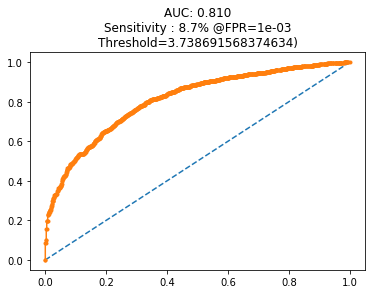

6 Train Loss: 0.8083
7 Train Loss: 0.7849
8 Train Loss: 0.7723
9 Train Loss: 0.7482
10 Train Loss: 0.7284

 ------------- 

[10] Time for 10 iterations: 30.7 mins, Train Loss: 0.7283945671692607


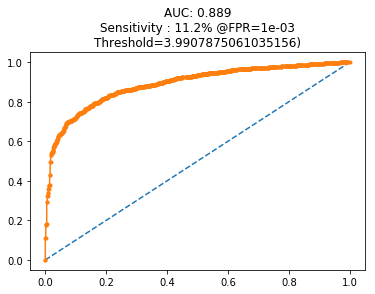

11 Train Loss: 0.7042
12 Train Loss: 0.6986
13 Train Loss: 0.6830
14 Train Loss: 0.6517
15 Train Loss: 0.6283

 ------------- 

[15] Time for 15 iterations: 44.4 mins, Train Loss: 0.6283073343409968


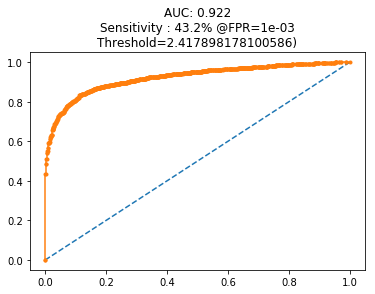

16 Train Loss: 0.6122
17 Train Loss: 0.6169
18 Train Loss: 0.6026
19 Train Loss: 0.5814
20 Train Loss: 0.5610

 ------------- 

[20] Time for 20 iterations: 58.2 mins, Train Loss: 0.561033413687044


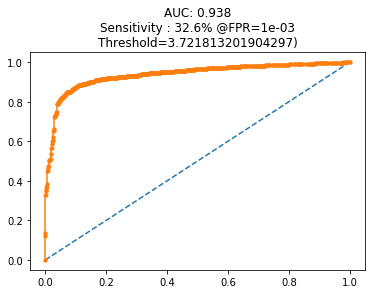

21 Train Loss: 0.5584
22 Train Loss: 0.5283
23 Train Loss: 0.5407
24 Train Loss: 0.5176
25 Train Loss: 0.5219

 ------------- 

[25] Time for 25 iterations: 71.9 mins, Train Loss: 0.5219423294932561


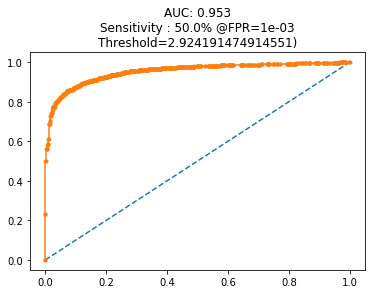

26 Train Loss: 0.5075
27 Train Loss: 0.4974
28 Train Loss: 0.4838
29 Train Loss: 0.4637
30 Train Loss: 0.4591

 ------------- 

[30] Time for 30 iterations: 85.6 mins, Train Loss: 0.4591409804908768


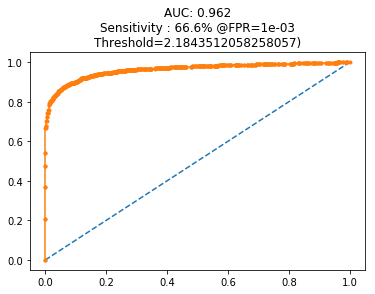

31 Train Loss: 0.4450
32 Train Loss: 0.4388
33 Train Loss: 0.4301
34 Train Loss: 0.4170
35 Train Loss: 0.3976

 ------------- 

[35] Time for 35 iterations: 99.4 mins, Train Loss: 0.3975982130160908


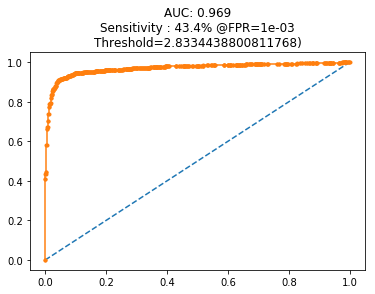

36 Train Loss: 0.4011
37 Train Loss: 0.3868
38 Train Loss: 0.3811
39 Train Loss: 0.3748
40 Train Loss: 0.3643

 ------------- 

[40] Time for 40 iterations: 113.2 mins, Train Loss: 0.36433839465806744


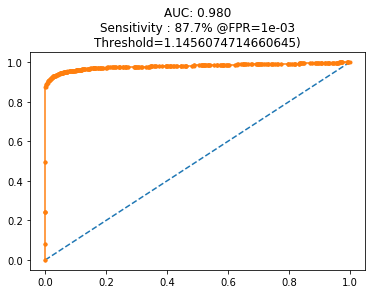

41 Train Loss: 0.3435
42 Train Loss: 0.3403
43 Train Loss: 0.3445
44 Train Loss: 0.3395
45 Train Loss: 0.3283

 ------------- 

[45] Time for 45 iterations: 126.9 mins, Train Loss: 0.32825299347540826


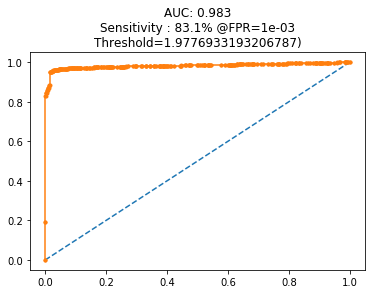

46 Train Loss: 0.3128
47 Train Loss: 0.3022
48 Train Loss: 0.2981
49 Train Loss: 0.2895
50 Train Loss: 0.2801

 ------------- 

[50] Time for 50 iterations: 140.7 mins, Train Loss: 0.2800829597029926


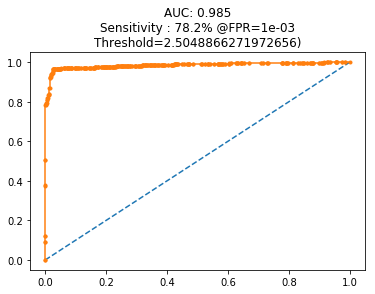

51 Train Loss: 0.2862
52 Train Loss: 0.2780
53 Train Loss: 0.2718
54 Train Loss: 0.2749
55 Train Loss: 0.2523

 ------------- 

[55] Time for 55 iterations: 154.4 mins, Train Loss: 0.2522695160950324


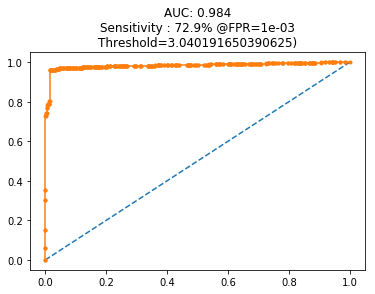

56 Train Loss: 0.2534
57 Train Loss: 0.2526
58 Train Loss: 0.2405
59 Train Loss: 0.2411
60 Train Loss: 0.2422

 ------------- 

[60] Time for 60 iterations: 168.1 mins, Train Loss: 0.24215227633390235


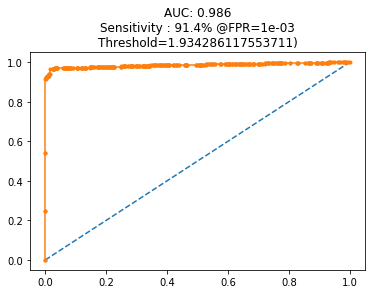

61 Train Loss: 0.2368
62 Train Loss: 0.2359
63 Train Loss: 0.2235
64 Train Loss: 0.2240
65 Train Loss: 0.2247

 ------------- 

[65] Time for 65 iterations: 181.9 mins, Train Loss: 0.22469295135831016


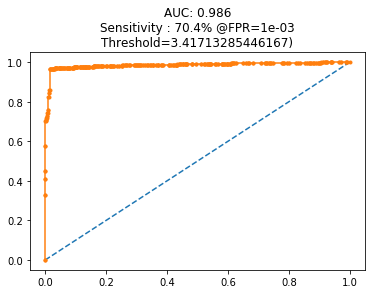

66 Train Loss: 0.2127
67 Train Loss: 0.2185
68 Train Loss: 0.2098
69 Train Loss: 0.2002
70 Train Loss: 0.2003

 ------------- 

[70] Time for 70 iterations: 195.7 mins, Train Loss: 0.2002528784187301


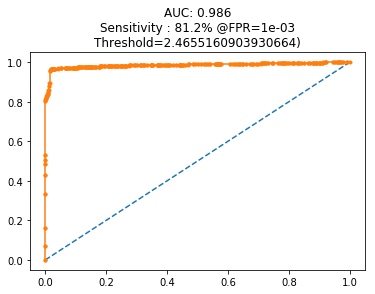

71 Train Loss: 0.1959
72 Train Loss: 0.1917
73 Train Loss: 0.1926
74 Train Loss: 0.2028
75 Train Loss: 0.1933

 ------------- 

[75] Time for 75 iterations: 209.4 mins, Train Loss: 0.19326208925203933


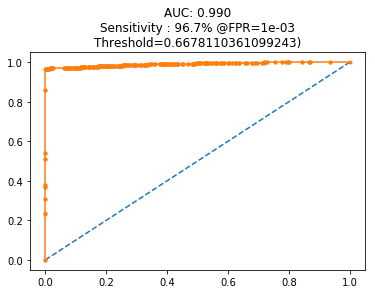

76 Train Loss: 0.1892
77 Train Loss: 0.1822
78 Train Loss: 0.1874
79 Train Loss: 0.1835
80 Train Loss: 0.1761

 ------------- 

[80] Time for 80 iterations: 223.2 mins, Train Loss: 0.17613612598801845


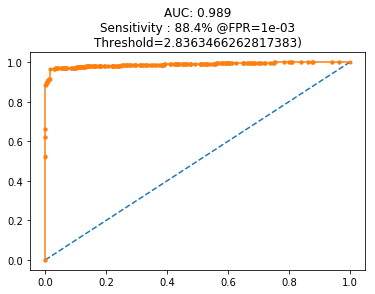

81 Train Loss: 0.1799
82 Train Loss: 0.1680
83 Train Loss: 0.1761
84 Train Loss: 0.1720
85 Train Loss: 0.1715

 ------------- 

[85] Time for 85 iterations: 236.9 mins, Train Loss: 0.17148134970739137


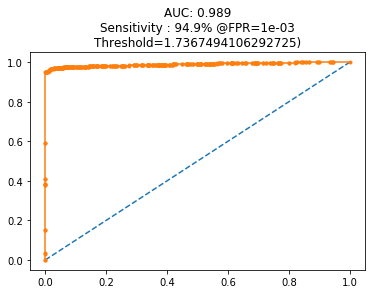

86 Train Loss: 0.1624
87 Train Loss: 0.1659
88 Train Loss: 0.1554
89 Train Loss: 0.1651
90 Train Loss: 0.1565

 ------------- 

[90] Time for 90 iterations: 250.6 mins, Train Loss: 0.15653688948101302


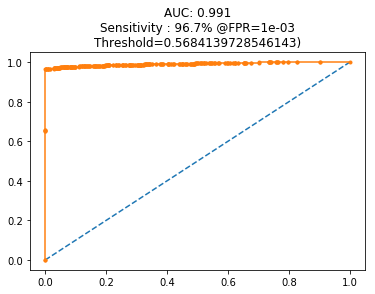

91 Train Loss: 0.1588
92 Train Loss: 0.1591
93 Train Loss: 0.1524
94 Train Loss: 0.1505
95 Train Loss: 0.1577

 ------------- 

[95] Time for 95 iterations: 264.4 mins, Train Loss: 0.1576674429832066


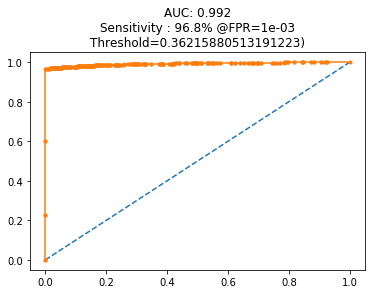

96 Train Loss: 0.1431
97 Train Loss: 0.1514
98 Train Loss: 0.1487
99 Train Loss: 0.1382


In [146]:
import time
train_losses = []
val_losses = []
val_accuracy = []
counter = []
iteration_number= 0
auc_epochs  = []
threshold_list = []

best_auc = -1
best_threshold = 0

print("Starting training process!")
print("-"*100)
t_start = time.time()

for epoch in range(Config.nepochs):
    train_loss = train(epoch)
    print('{} Train Loss: {:.4f}'.format(epoch,train_loss))
    train_losses.append(train_loss)
    if epoch % 5 == 0:
        print("\n ------------- \n")
        print("[{3}] Time for {0} iterations: {1:.1f} mins, Train Loss: {2}".format(epoch, (time.time()-t_start)/60.0,train_loss,epoch))
        probs,yprob = compute_prob(model, val_origin[:,:,:,:],val_y_origin[:])
        fpr, tpr, thresholds,auc = compute_metrics(probs,yprob)
        if auc>best_auc:
            best_auc = auc
            best_threshold = thresholds
            ## Save model
            torch.save(model.state_dict(), './best_siamese_contrastive_loss.pth')
        draw_roc(fpr,tpr, thresholds)
        
        ## Save Metrics
        auc_epochs.append(auc)
        threshold_list.append(thresholds)

Text(0.5, 1.0, 'Train Loss over epochs')

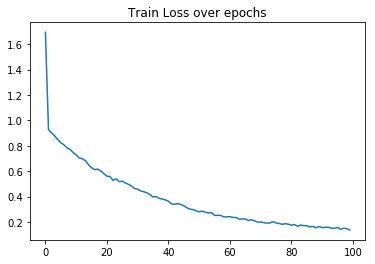

In [147]:

plt.plot(train_losses)
plt.title("Train Loss over epochs")

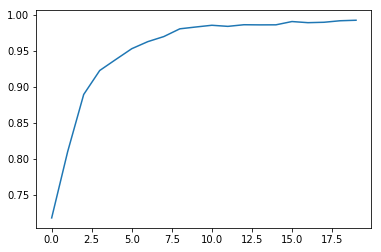

In [148]:
plt.plot(auc_epochs)

In [22]:
checkpoint = torch.load("best_siamese_contrastive_loss.pth")
model.load_state_dict(checkpoint)
print("=> loaded checkpoint ")

=> loaded checkpoint 


## Test 

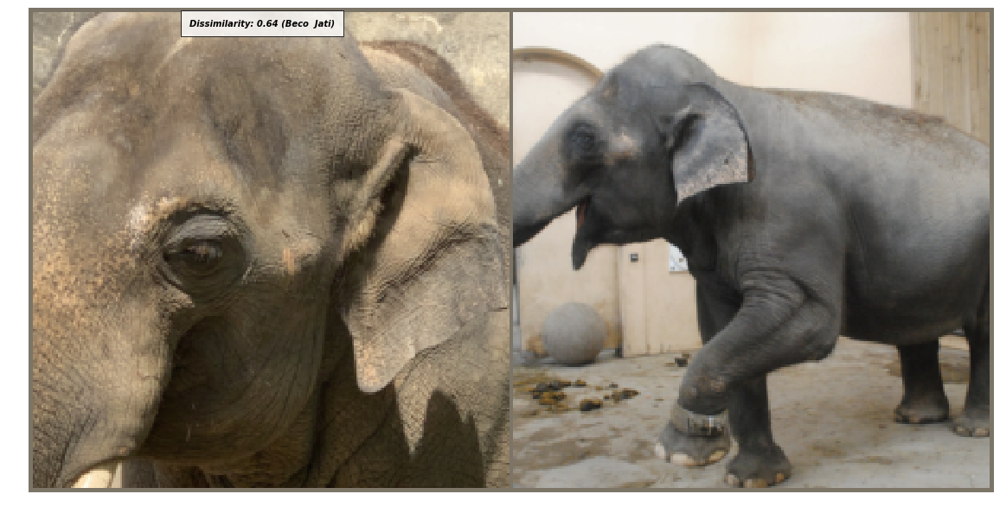

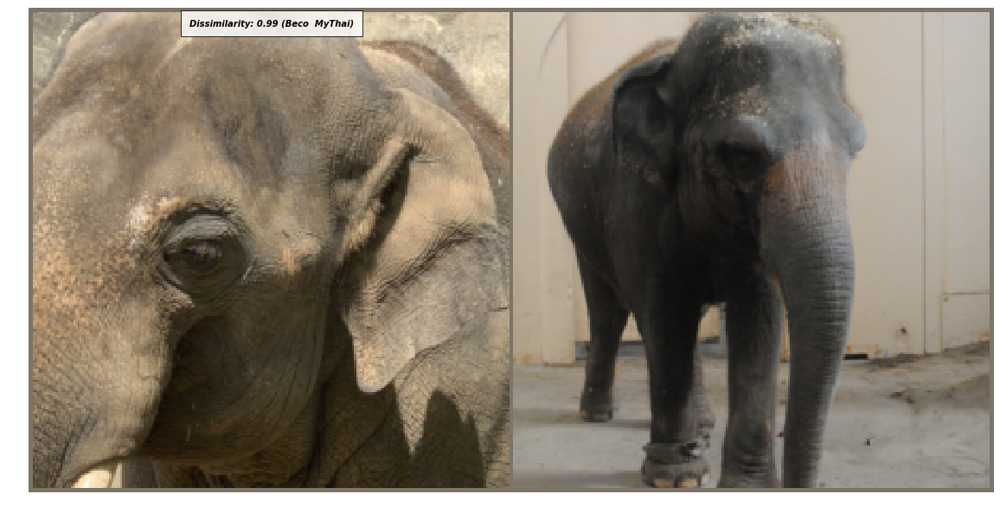

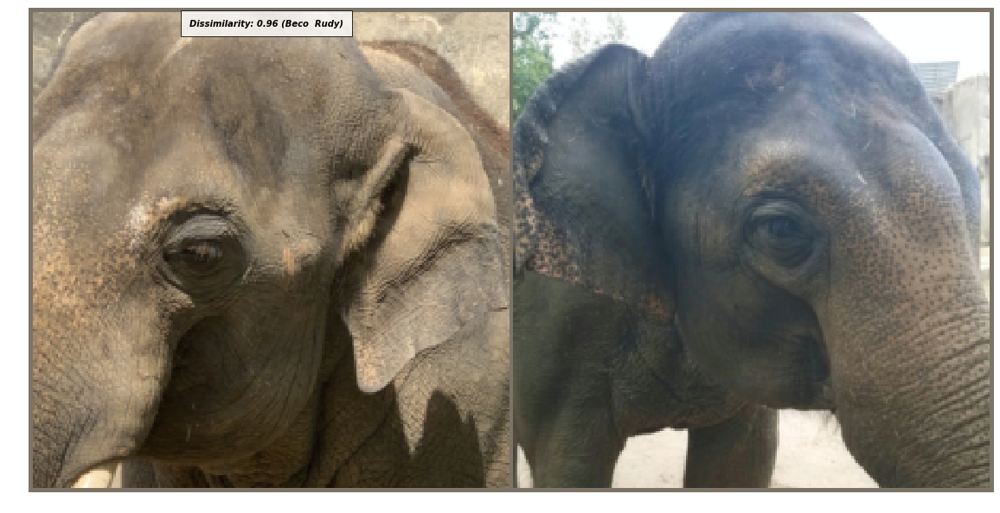

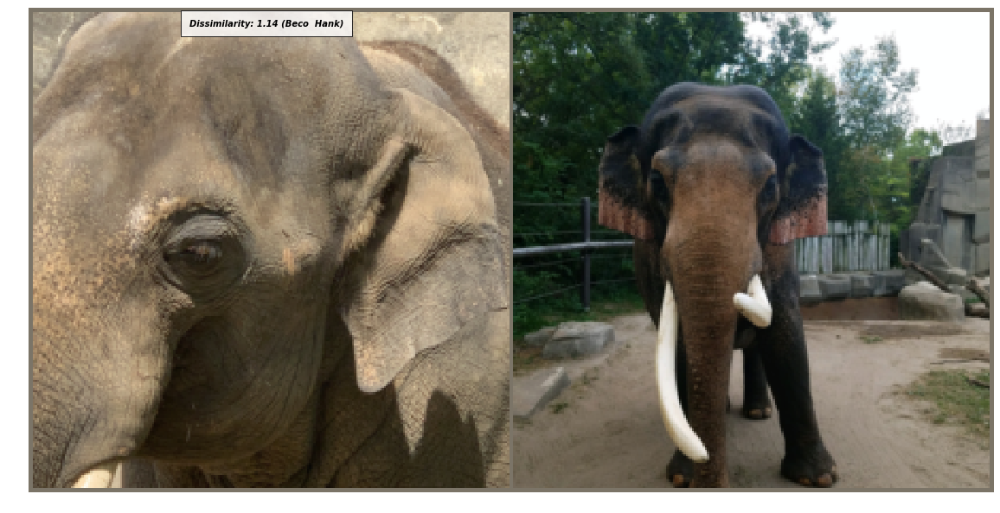

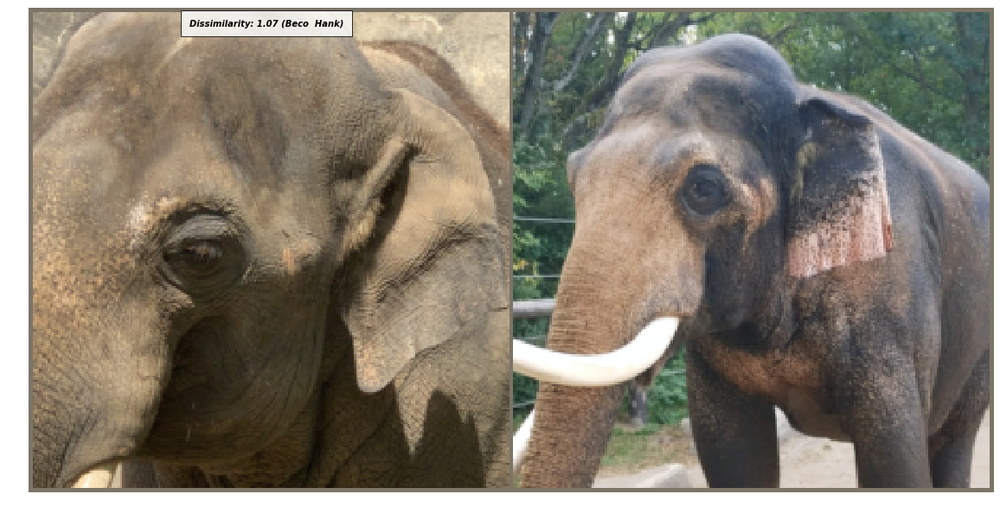

...

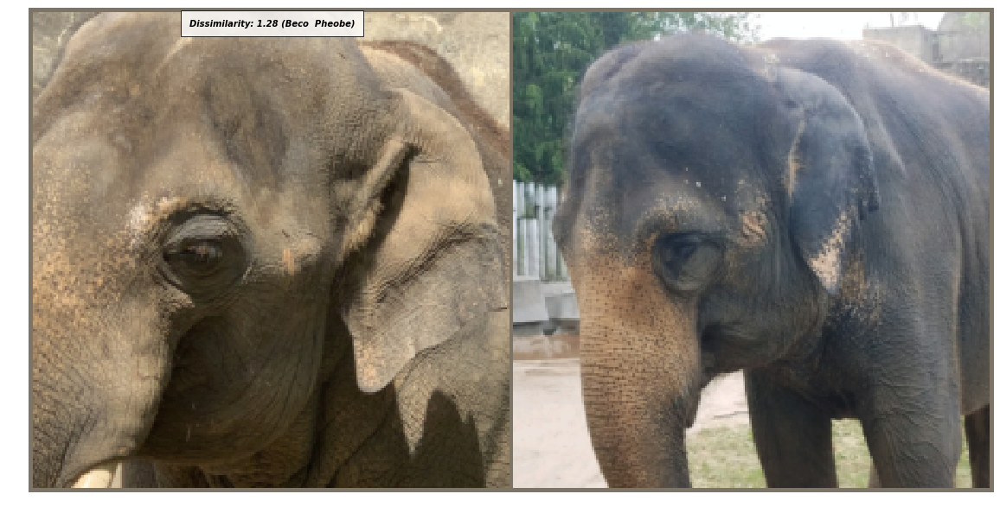

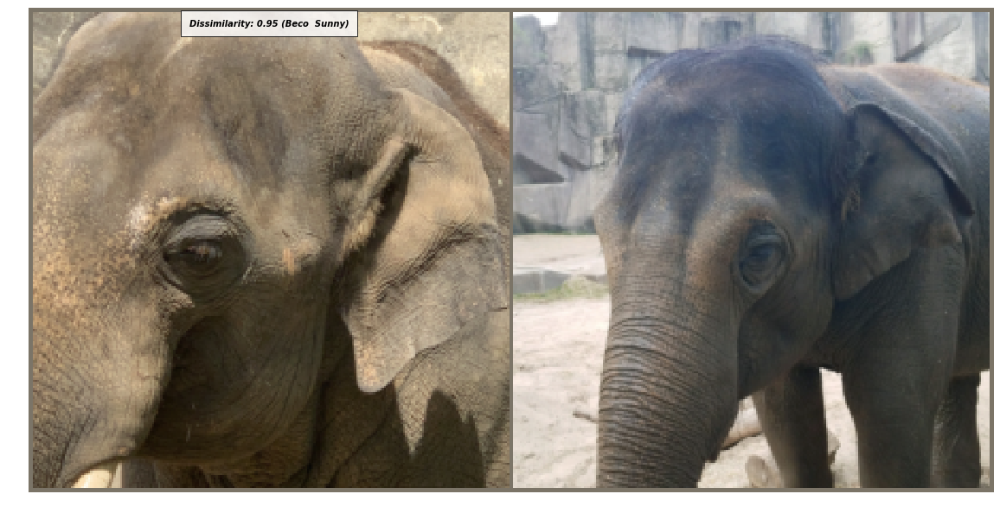

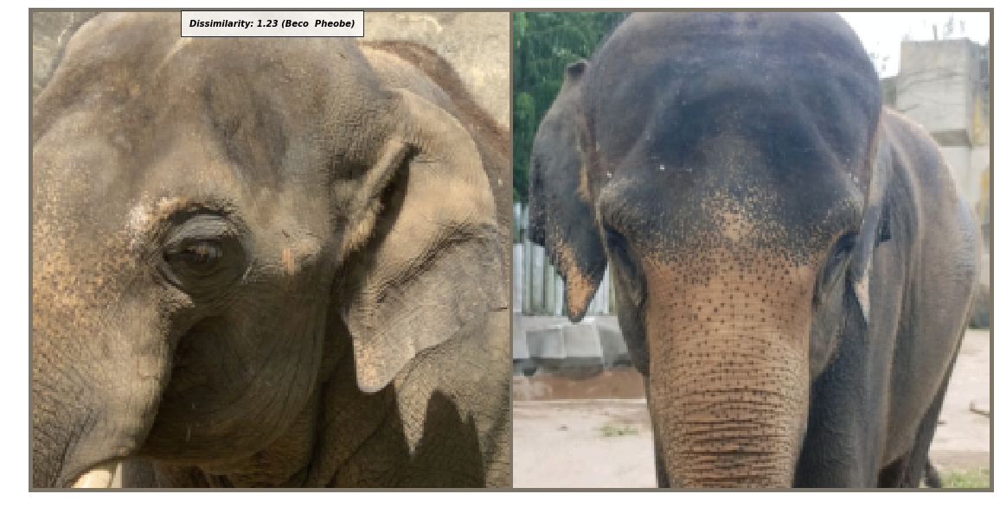

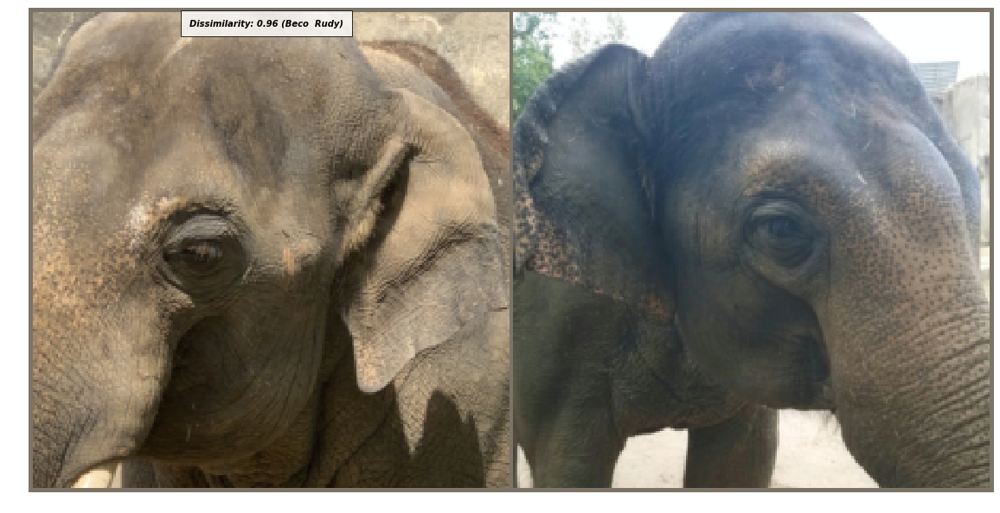

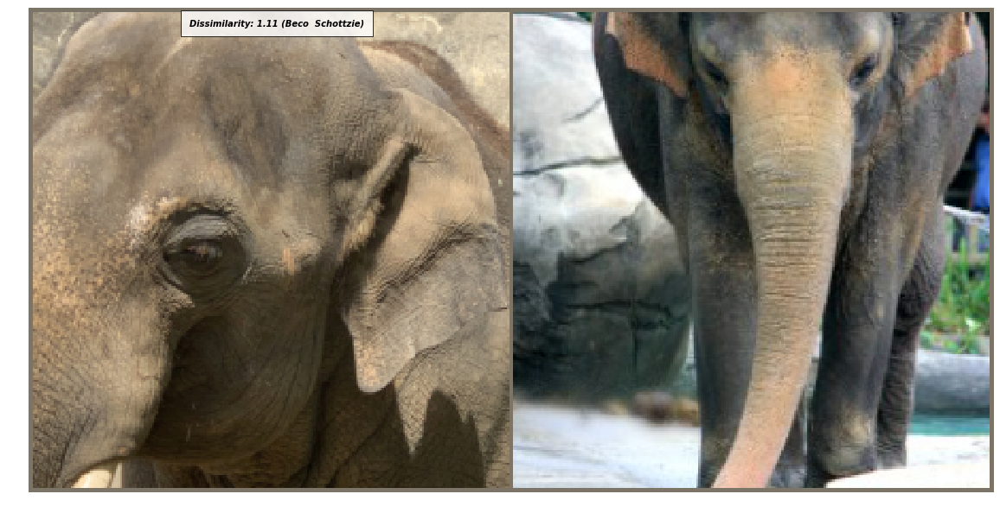

In [33]:
def image_show(img,text=None,should_save=False):
    npimg = img.numpy()
    plt.axis("off")
    if text:
        plt.text(75, 8, text, style='italic',fontweight='bold',
            bbox={'facecolor':'white', 'alpha':0.8, 'pad':10})
    plt.imshow(np.transpose(npimg, (1,2, 0)))
    plt.show()    
    
folder_dataset_test = dset.ImageFolder(root=Config.test_dir)
siamese_dataset = AsianElephantSiemeseDataset(folder_dataset_test,
                                        transform=data_transforms["test"]
                                       )



## take one gallery image
val_dataiter = iter(val_loader)
x0,actual_label0 = next(val_dataiter)
x0 = x0[1]
x0 = x0.unsqueeze(0)
actual_label0 = actual_label0[1]

dataiter = iter(test_dataloader)
test_dataloader = DataLoader(siamese_dataset,num_workers=1,batch_size=1,shuffle=True)
for i in range(len(test_dataloader)):
    _,x1,label2, actual_labels = next(dataiter)
    concatenated = torch.cat((x0,x1),0)
    output1,output2 = model(Variable(x0).cuda(),Variable(x1).cuda())
    euclidean_distance = F.pairwise_distance(output1, output2)
    imshow(torchvision.utils.make_grid(concatenated),'Dissimilarity: {:.2f}'.format(euclidean_distance.item())+ f" ({classes[actual_label0]}  {classes[actual_labels[1]]})")

## Evaluate AUC and ROC 

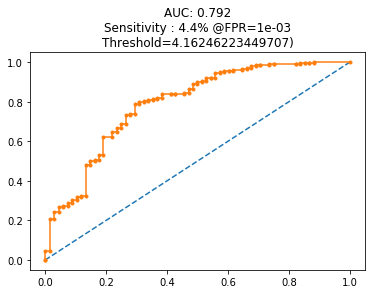

In [165]:
test_image_folder = dset.ImageFolder(root = Config.test_dir, transform=data_transforms["test"])

test_all_loader = torch.utils.data.DataLoader(test_image_folder,batch_size=len(test_image_folder), sampler=None,num_workers=4,pin_memory=True,shuffle=True)

test_origin, test_y_origin = next(iter(test_all_loader))

probs,yprob = compute_prob(model, test_origin[:,:,:,:],test_y_origin[:])
fpr, tpr, thresholds,auc = compute_metrics(probs,yprob)
draw_roc(fpr,tpr, thresholds)

### Query Images - New Test Photos

Query images are handpicked from the "New Test Photos" folder:

Actual Names:

1. Hank - IMG_4482.JPG
2. Jati - DSC_0580.JPG
3. Sunny - IMG_4494.JPG


Query Images


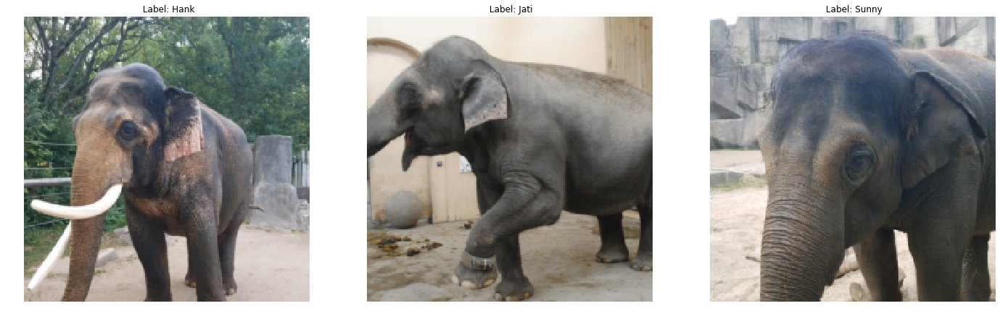

In [87]:
query_image_folder = dset.ImageFolder(root = Config.query_dir, transform=data_transforms["test"])

query_image_dataloader =torch.utils.data.DataLoader(query_image_folder,batch_size = 3, shuffle=False)
query_images, query_y = next(iter(query_image_dataloader))
query_labels = ["Hank","Jati","Sunny"]

fig = plt.figure(figsize= (24,20))
print("Query Images")
for i in range(3):
    plt.subplot(1, 3, (i+1))
    
    
    image = np.transpose(query_images[i].numpy(),(1,2,0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    image = std * image + mean
    image = np.clip(image, 0, 1)
    plt.axis("off")
    plt.imshow(image)
    plt.title(f" Label: {query_labels[i]}")
plt.show()

### Template Images - Gallery Images  (Super Clean Images)

Gallery Images are handpicked from the super clean images

Actual Names:

1. Beco - IMG_7267.JPG
2. Connie - IMG_2381.JPG
3. Hank - IMG_7099.JPG
4. Jati - IMG_3104.JPG
5. Kamala - IMG_2396.JPG
6. Maharani - IMG_3589.JPG
7. MyThai - IMG_3505.JPG
8. Pheobe - IMG_5423.JPG
9. Rudy - IMG_0297.JPG
10. Sabu - IMG_4228.JPG
11. Schottzie - IMG_5316.JPG
12. Spike - IMG_0807.JPG
13. Sunny - IMG_9144.JPG
14. Swarna - IMG_9901.JPG


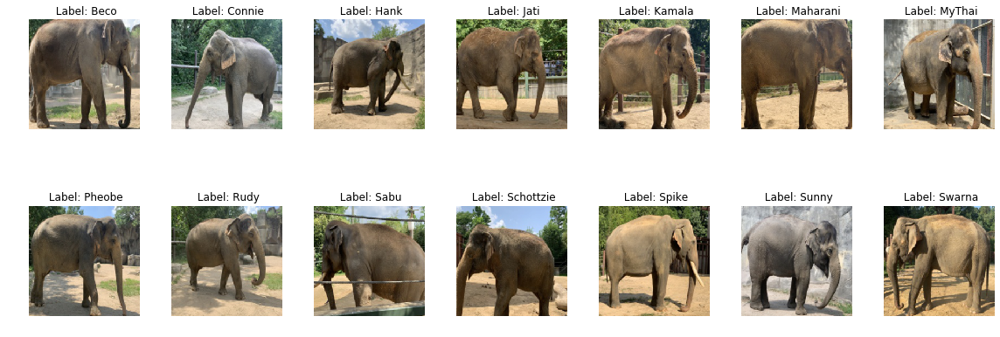

In [117]:
dataset_gallery = []
classes = gallery_image_folder.classes

fig = plt.figure(figsize=(16,12))
for n in range(Config.num_classes):
    
    ax1 = plt.subplot(4, 7, (n+1))
    images_class_n = ([row for idx,row in enumerate(gallery_origin) if gallery_y_origin[idx]==n])[0]
    dataset_gallery.append(images_class_n)
    npimg = images_class_n.numpy()
        
    image = np.transpose(npimg,(1,2,0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    image = std * image + mean
    image = np.clip(image, 0, 1)
    
    ax1.set_aspect('equal')
    plt.axis("off")
    plt.imshow(image)
    plt.title(f" Label: {classes[n]}")
    

plt.subplots_adjust(wspace=0, hspace=0)
plt.tight_layout()
plt.show()



In [183]:
## Distance of three test inputs
%matplotlib inline
def display_elephant(img):
    npimg = img.numpy()
    image = np.transpose(npimg,(1,2,0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    image = std * image + mean
    image = np.clip(image, 0, 1)
    plt.axis("Off")
    
    plt.imshow(image)
    
def test_image(model, gallery_images,gallery_image_classes, query_image, query_image_label):
    
    """
    Test some images - with respect to the distance between test image class and rest of the classes
    """
    nbimages = len(gallery_images)
    gallery_image_embeddings = []
    for i in range(len(gallery_images)):
        plt.subplot(2,8,(i+1))
        display_elephant(gallery_images[i])
        plt.title(gallery_image_classes[i])
        gallery_image_embeddings.append(model.module.forward_once(gallery_images[i].unsqueeze(0).cuda()).detach().cpu().numpy())
    plt.show()
    nb_classes = Config.num_classes
    gallery_image_embeddings = np.array(gallery_image_embeddings)
    
    ## testloader
    ref_embedings = model.module.forward_once(query_image.unsqueeze(0).cuda())
    ref_embedings = ref_embedings.detach().cpu()
    ref_embedings = ref_embedings[0]
    
    ref_embedings  = ref_embedings.numpy()
    ## figure
    plotidx = 0
    plt.title("Test image:  " + query_image_label)
    display_elephant(query_image)
    plt.show()
    distances = []
    figure = plt.figure(figsize=(30,20))
    for ref in range(nb_classes):
         
        #Compute distance between this images and references
        
        dist = np.sum(np.square(gallery_image_embeddings[ref][0]-ref_embedings))
        distances.append(dist)
        
        #Draw
        ax1 = plt.subplot(4, 4, (plotidx+1))
        display_elephant(gallery_images[ref])
        plt.title(("Class {0}\n{1:.3e}".format(gallery_image_classes[ref],dist)))
        plotidx += 1
    
    
    
    sort_index = np.argsort(distances)
    print([gallery_image_classes[i]+ f"({str(distances[i])})" for i in sort_index])
    plt.tight_layout()
    plt.show()

### Evaluate The Distance of Query Images - Template Images

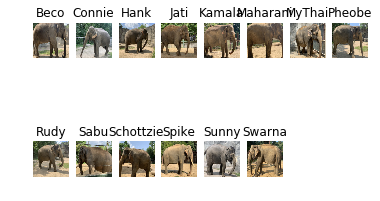

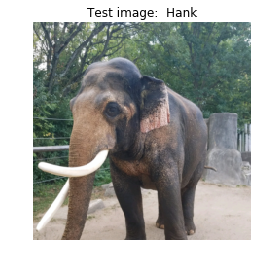

['Maharani(0.03323084)', 'Pheobe(0.045926645)', 'Connie(0.7893362)', 'Rudy(1.1529723)', 'Beco(1.7705424)', 'Schottzie(2.0023322)', 'MyThai(2.054141)', 'Jati(2.0807338)', 'Kamala(2.1041074)', 'Hank(2.301918)', 'Sabu(2.4811277)', 'Sunny(2.740385)', 'Swarna(2.8319802)', 'Spike(3.0417252)']


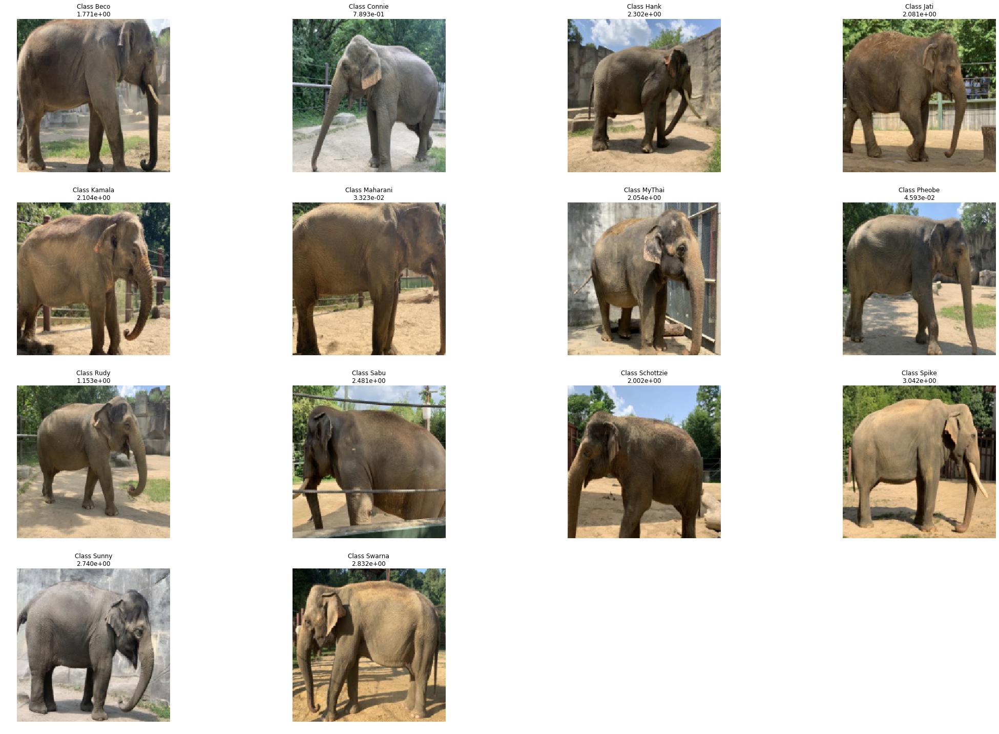

In [184]:
test_image(model, dataset_gallery,gallery_image_folder.classes, query_images[0], query_labels[0])

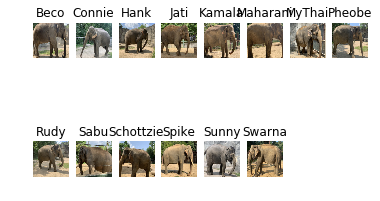

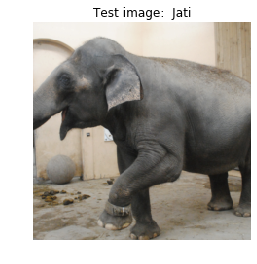

['Rudy(0.30005062)', 'Beco(0.41060233)', 'MyThai(0.62862825)', 'Connie(0.63804924)', 'Schottzie(0.6695119)', 'Maharani(0.7398989)', 'Hank(0.79178745)', 'Pheobe(0.82787615)', 'Jati(0.8361558)', 'Sabu(0.9129197)', 'Sunny(1.0090086)', 'Kamala(1.1725237)', 'Swarna(1.2495974)', 'Spike(1.6982957)']


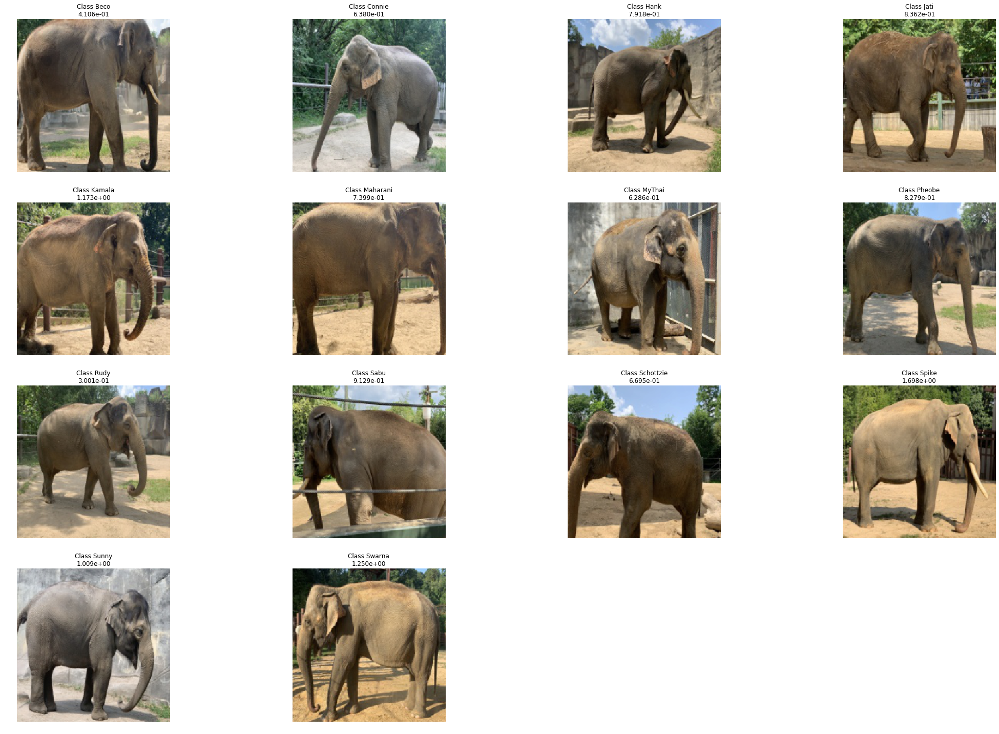

In [185]:
test_image(model, dataset_gallery,gallery_image_folder.classes, query_images[1], query_labels[1])

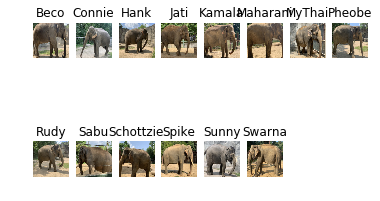

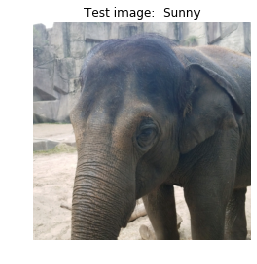

['Maharani(0.16081496)', 'Connie(0.17174706)', 'Pheobe(0.32495803)', 'Rudy(0.41316837)', 'Beco(1.028135)', 'MyThai(1.1529865)', 'Kamala(1.2106812)', 'Jati(1.2449841)', 'Schottzie(1.3358204)', 'Hank(1.6620648)', 'Sunny(1.740246)', 'Sabu(1.7453585)', 'Swarna(1.9330876)', 'Spike(2.389235)']


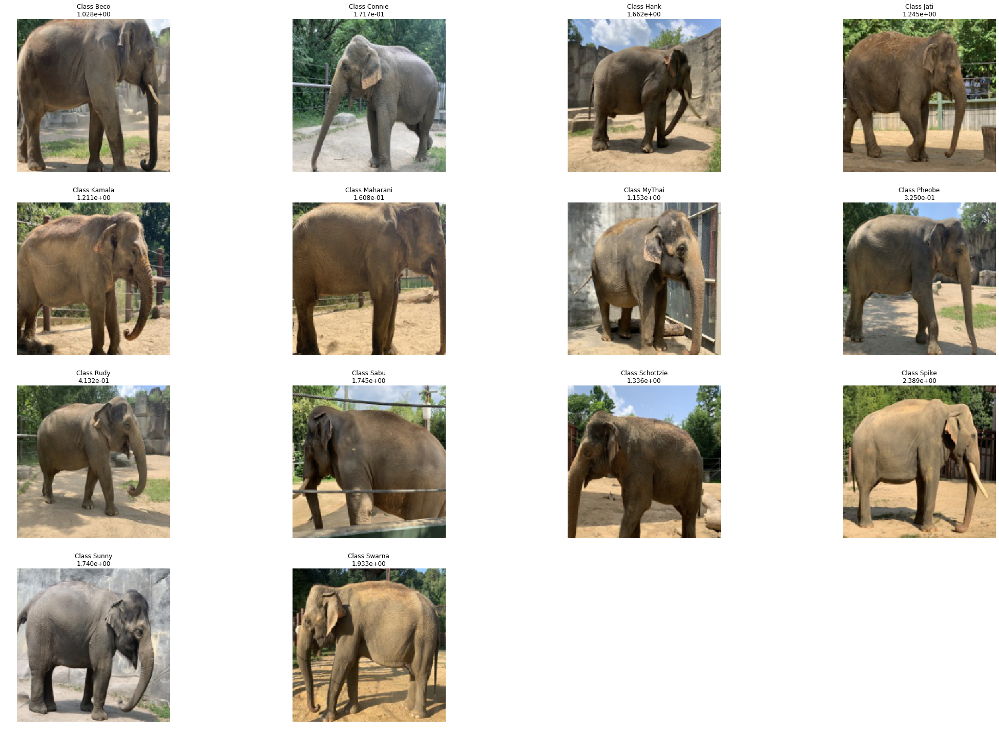

In [186]:
test_image(model, dataset_gallery,gallery_image_folder.classes, query_images[2], query_labels[2])